<a href="https://colab.research.google.com/github/FernandoV17/IA_VERANOS/blob/act4/act4/act4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!wget https://raw.githubusercontent.com/FernandoV17/IA_VERANOS/refs/heads/act4/act4/data/data.csv

--2025-07-09 03:54:13--  https://raw.githubusercontent.com/FernandoV17/IA_VERANOS/refs/heads/act4/act4/data/data.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 124635 (122K) [text/plain]
Saving to: ‘data.csv’

data.csv            100%[===================>] 121.71K  --.-KB/s    in 0.03s   

2025-07-09 03:54:13 (4.18 MB/s) - ‘data.csv’ saved [124635/124635]



In [2]:
#Si Clonaste el Respositorio
data_path = '/content/IA_VERANOS/act4/data/data.csv'

In [3]:
#Si nada mas usas google collab
data_path = '/content/data.csv'

In [26]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn import tree
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import accuracy_score, classification_report

In [5]:
df = pd.read_csv(data_path)

In [6]:
if 'Unnamed: 32' in df.columns:
    df = df.drop(columns=['Unnamed: 32'])

In [7]:
print("Cantidad Total de Datos",df.shape[0])
print("Total number of features(as number of columns) are ",
df.shape[1])
df.describe()

Cantidad Total de Datos 569
Total number of features(as number of columns) are  32


,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [8]:
display(
    df.head().style
    .set_properties(**{'text-align': 'center'})
    .format("{:.2f}", subset=df.select_dtypes(include=['float']).columns)
)

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.00,0.12,0.28,0.30,0.15,0.24,0.08,1.09,0.91,8.59,153.40,0.01,0.05,0.05,0.02,0.03,0.01,25.38,17.33,184.60,2019.00,0.16,0.67,0.71,0.27,0.46,0.12
1,842517,M,20.57,17.77,132.90,1326.00,0.08,0.08,0.09,0.07,0.18,0.06,0.54,0.73,3.40,74.08,0.01,0.01,0.02,0.01,0.01,0.00,24.99,23.41,158.80,1956.00,0.12,0.19,0.24,0.19,0.28,0.09
2,84300903,M,19.69,21.25,130.00,1203.00,0.11,0.16,0.20,0.13,0.21,0.06,0.75,0.79,4.58,94.03,0.01,0.04,0.04,0.02,0.02,0.00,23.57,25.53,152.50,1709.00,0.14,0.42,0.45,0.24,0.36,0.09
3,84348301,M,11.42,20.38,77.58,386.10,0.14,0.28,0.24,0.11,0.26,0.10,0.50,1.16,3.44,27.23,0.01,0.07,0.06,0.02,0.06,0.01,14.91,26.50,98.87,567.70,0.21,0.87,0.69,0.26,0.66,0.17
4,84358402,M,20.29,14.34,135.10,1297.00,0.10,0.13,0.20,0.10,0.18,0.06,0.76,0.78,5.44,94.44,0.01,0.02,0.06,0.02,0.02,0.01,22.54,16.67,152.20,1575.00,0.14,0.20,0.40,0.16,0.24,0.08



Análisis de valores nulos en el dataset:


,Conteo Nulos
id,0
diagnosis,0
radius_mean,0
texture_mean,0
perimeter_mean,0
area_mean,0
smoothness_mean,0
compactness_mean,0
concavity_mean,0
concave points_mean,0



Valores cero en columnas clave:


,Conteo Ceros
id,0
radius_mean,0
texture_mean,0
perimeter_mean,0
area_mean,0
smoothness_mean,0
compactness_mean,0
concavity_mean,13
concave points_mean,13
symmetry_mean,0


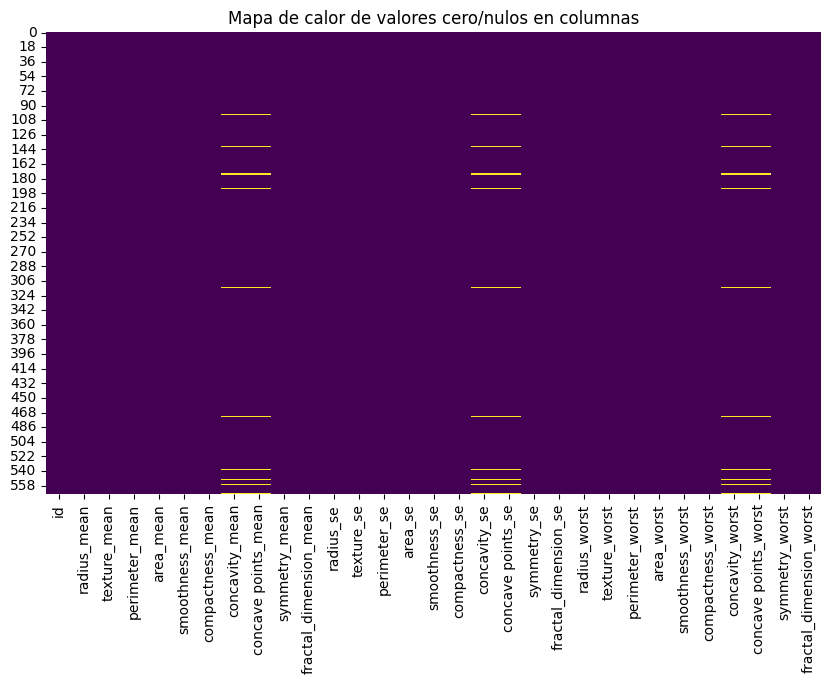


Filas con valores nulos o ceros problemáticos:

--- concavity_mean ---


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
101,862722,B,6.981,13.43,43.79,143.5,0.11700,0.07568,0.0,0.0,...,7.930,19.54,50.41,185.2,0.15840,0.12020,0.0,0.0,0.2932,0.09382
140,868999,B,9.738,11.97,61.24,288.5,0.09250,0.04102,0.0,0.0,...,10.620,14.10,66.53,342.9,0.12340,0.07204,0.0,0.0,0.3105,0.08151
174,871642,B,10.660,15.15,67.49,349.6,0.08792,0.04302,0.0,0.0,...,11.540,19.20,73.20,408.3,0.10760,0.06791,0.0,0.0,0.2710,0.06164
175,872113,B,8.671,14.45,54.42,227.2,0.09138,0.04276,0.0,0.0,...,9.262,17.04,58.36,259.2,0.11620,0.07057,0.0,0.0,0.2592,0.07848
192,875099,B,9.720,18.22,60.73,288.1,0.06950,0.02344,0.0,0.0,...,9.968,20.83,62.25,303.8,0.07117,0.02729,0.0,0.0,0.1909,0.06559



--- concave points_mean ---


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
101,862722,B,6.981,13.43,43.79,143.5,0.11700,0.07568,0.0,0.0,...,7.930,19.54,50.41,185.2,0.15840,0.12020,0.0,0.0,0.2932,0.09382
140,868999,B,9.738,11.97,61.24,288.5,0.09250,0.04102,0.0,0.0,...,10.620,14.10,66.53,342.9,0.12340,0.07204,0.0,0.0,0.3105,0.08151
174,871642,B,10.660,15.15,67.49,349.6,0.08792,0.04302,0.0,0.0,...,11.540,19.20,73.20,408.3,0.10760,0.06791,0.0,0.0,0.2710,0.06164
175,872113,B,8.671,14.45,54.42,227.2,0.09138,0.04276,0.0,0.0,...,9.262,17.04,58.36,259.2,0.11620,0.07057,0.0,0.0,0.2592,0.07848
192,875099,B,9.720,18.22,60.73,288.1,0.06950,0.02344,0.0,0.0,...,9.968,20.83,62.25,303.8,0.07117,0.02729,0.0,0.0,0.1909,0.06559



--- concavity_se ---


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
101,862722,B,6.981,13.43,43.79,143.5,0.11700,0.07568,0.0,0.0,...,7.930,19.54,50.41,185.2,0.15840,0.12020,0.0,0.0,0.2932,0.09382
140,868999,B,9.738,11.97,61.24,288.5,0.09250,0.04102,0.0,0.0,...,10.620,14.10,66.53,342.9,0.12340,0.07204,0.0,0.0,0.3105,0.08151
174,871642,B,10.660,15.15,67.49,349.6,0.08792,0.04302,0.0,0.0,...,11.540,19.20,73.20,408.3,0.10760,0.06791,0.0,0.0,0.2710,0.06164
175,872113,B,8.671,14.45,54.42,227.2,0.09138,0.04276,0.0,0.0,...,9.262,17.04,58.36,259.2,0.11620,0.07057,0.0,0.0,0.2592,0.07848
192,875099,B,9.720,18.22,60.73,288.1,0.06950,0.02344,0.0,0.0,...,9.968,20.83,62.25,303.8,0.07117,0.02729,0.0,0.0,0.1909,0.06559



--- concave points_se ---


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
101,862722,B,6.981,13.43,43.79,143.5,0.11700,0.07568,0.0,0.0,...,7.930,19.54,50.41,185.2,0.15840,0.12020,0.0,0.0,0.2932,0.09382
140,868999,B,9.738,11.97,61.24,288.5,0.09250,0.04102,0.0,0.0,...,10.620,14.10,66.53,342.9,0.12340,0.07204,0.0,0.0,0.3105,0.08151
174,871642,B,10.660,15.15,67.49,349.6,0.08792,0.04302,0.0,0.0,...,11.540,19.20,73.20,408.3,0.10760,0.06791,0.0,0.0,0.2710,0.06164
175,872113,B,8.671,14.45,54.42,227.2,0.09138,0.04276,0.0,0.0,...,9.262,17.04,58.36,259.2,0.11620,0.07057,0.0,0.0,0.2592,0.07848
192,875099,B,9.720,18.22,60.73,288.1,0.06950,0.02344,0.0,0.0,...,9.968,20.83,62.25,303.8,0.07117,0.02729,0.0,0.0,0.1909,0.06559



--- concavity_worst ---


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
101,862722,B,6.981,13.43,43.79,143.5,0.11700,0.07568,0.0,0.0,...,7.930,19.54,50.41,185.2,0.15840,0.12020,0.0,0.0,0.2932,0.09382
140,868999,B,9.738,11.97,61.24,288.5,0.09250,0.04102,0.0,0.0,...,10.620,14.10,66.53,342.9,0.12340,0.07204,0.0,0.0,0.3105,0.08151
174,871642,B,10.660,15.15,67.49,349.6,0.08792,0.04302,0.0,0.0,...,11.540,19.20,73.20,408.3,0.10760,0.06791,0.0,0.0,0.2710,0.06164
175,872113,B,8.671,14.45,54.42,227.2,0.09138,0.04276,0.0,0.0,...,9.262,17.04,58.36,259.2,0.11620,0.07057,0.0,0.0,0.2592,0.07848
192,875099,B,9.720,18.22,60.73,288.1,0.06950,0.02344,0.0,0.0,...,9.968,20.83,62.25,303.8,0.07117,0.02729,0.0,0.0,0.1909,0.06559



--- concave points_worst ---


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
101,862722,B,6.981,13.43,43.79,143.5,0.11700,0.07568,0.0,0.0,...,7.930,19.54,50.41,185.2,0.15840,0.12020,0.0,0.0,0.2932,0.09382
140,868999,B,9.738,11.97,61.24,288.5,0.09250,0.04102,0.0,0.0,...,10.620,14.10,66.53,342.9,0.12340,0.07204,0.0,0.0,0.3105,0.08151
174,871642,B,10.660,15.15,67.49,349.6,0.08792,0.04302,0.0,0.0,...,11.540,19.20,73.20,408.3,0.10760,0.06791,0.0,0.0,0.2710,0.06164
175,872113,B,8.671,14.45,54.42,227.2,0.09138,0.04276,0.0,0.0,...,9.262,17.04,58.36,259.2,0.11620,0.07057,0.0,0.0,0.2592,0.07848
192,875099,B,9.720,18.22,60.73,288.1,0.06950,0.02344,0.0,0.0,...,9.968,20.83,62.25,303.8,0.07117,0.02729,0.0,0.0,0.1909,0.06559


In [9]:
print("\nAnálisis de valores nulos en el dataset:")
null_analysis = df.isnull().sum().to_frame('Conteo Nulos')
display(null_analysis.style.set_caption("Conteo de valores nulos por columna"))

key_columns = df.select_dtypes(include=['int', 'float']).columns.tolist()
print("\nValores cero en columnas clave:")
zero_analysis = df.select_dtypes(include=['int', 'float']).isin([0]).sum().to_frame('Conteo Ceros')
display(zero_analysis.style.set_caption("Conteo de valores cero en columnas numéricas"))

# Visualización
plt.figure(figsize=(10, 6))
sns.heatmap(df[key_columns].isin([0, np.nan]), cmap='viridis', cbar=False)
plt.title("Mapa de calor de valores cero/nulos en columnas")
plt.show()

print("\nFilas con valores nulos o ceros problemáticos:")
for col in key_columns:
    zero_or_null = df[df[col].isin([0, np.nan])]
    if not zero_or_null.empty:
        print(f"\n--- {col} ---")
        display(zero_or_null.head())

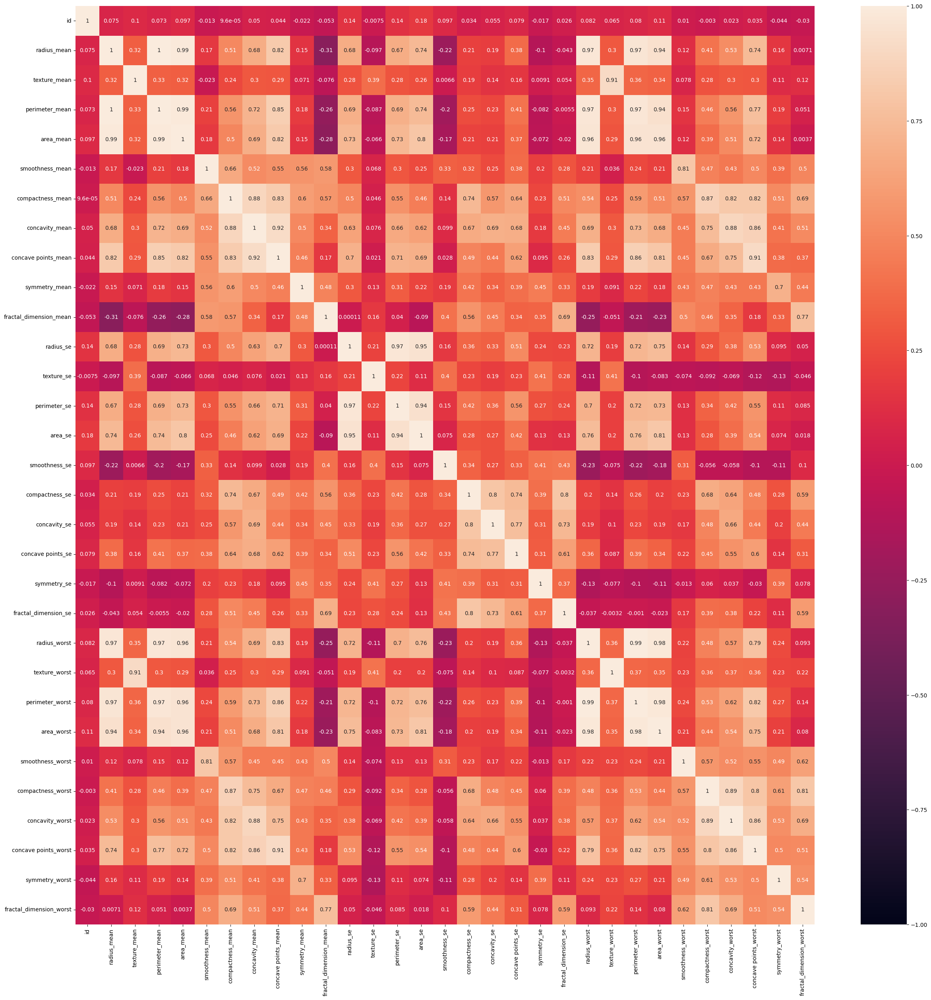

In [10]:
plt.figure(figsize=(30, 30))
sns.heatmap(df.select_dtypes(include='number').corr(), vmin=-1, vmax=1, annot=True)
plt.show()

<Axes: >

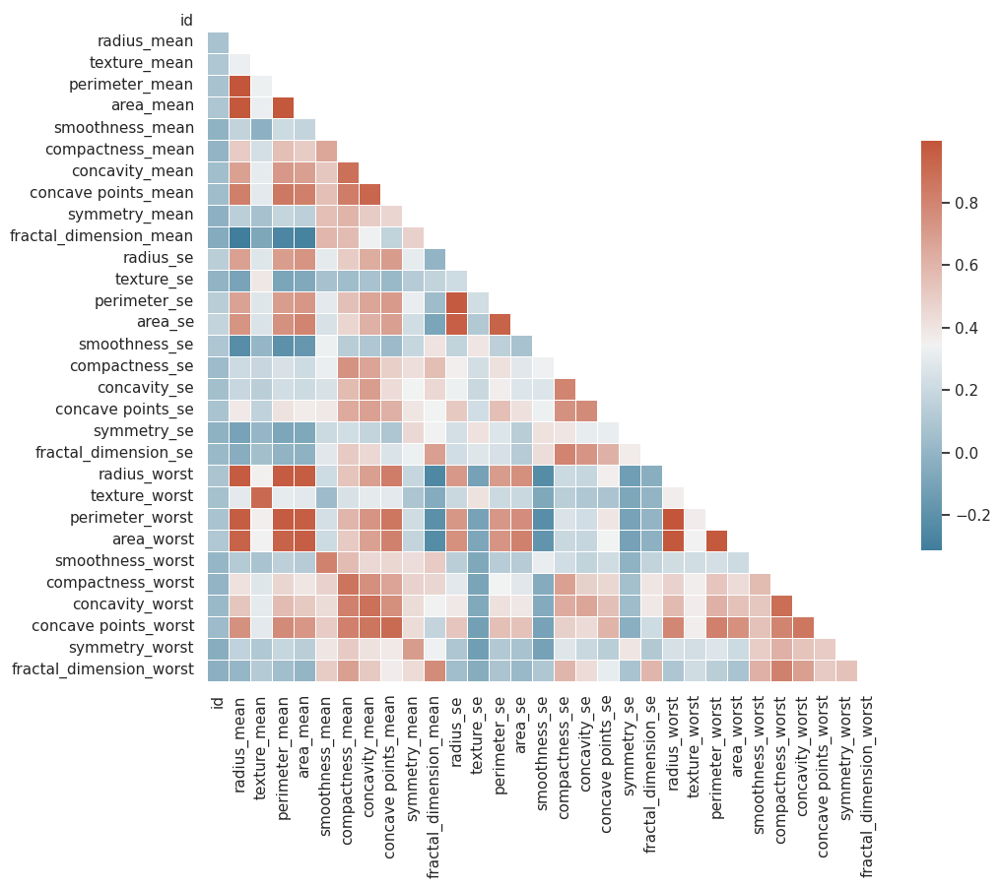

In [11]:
sns.set_theme(style="white")
corr = df.select_dtypes(include='number').corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap,square=True, linewidths=.5, cbar_kws={"shrink": .6})

In [12]:
sns.pairplot(df, hue = "diagnosis", diag_kind='kde')
plt.show()

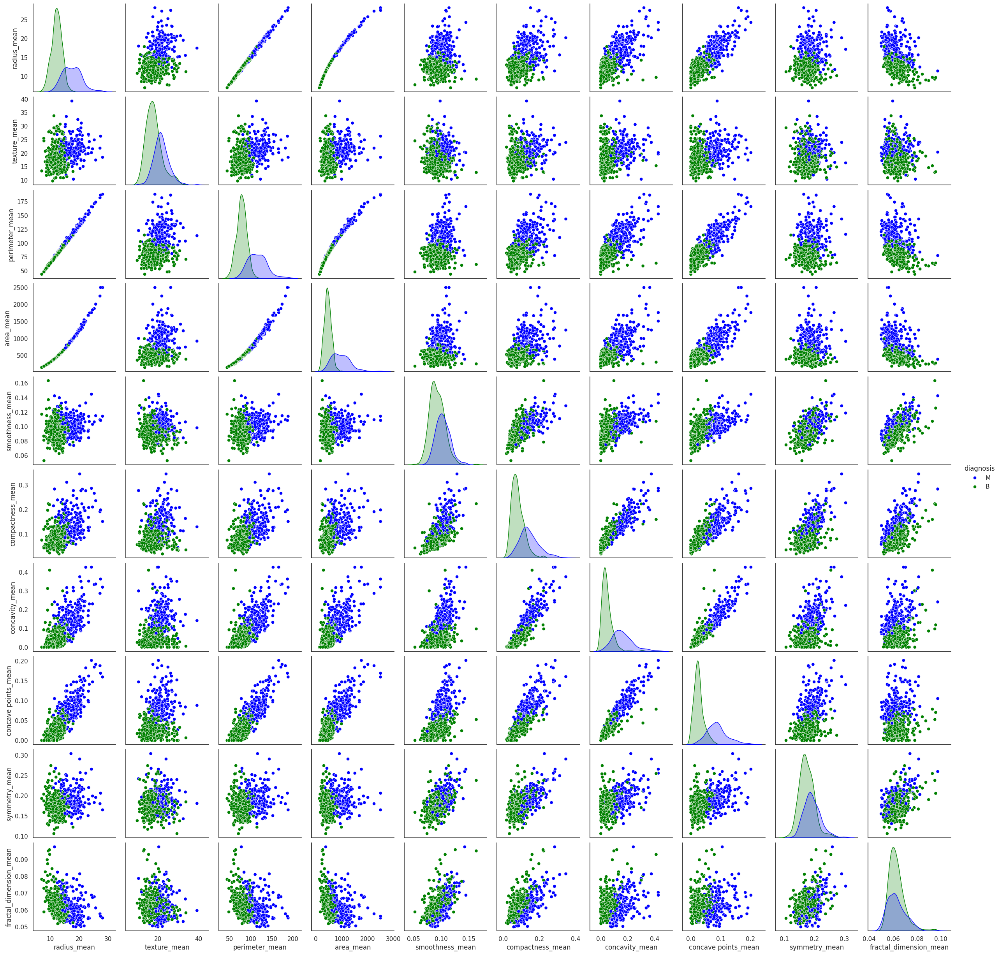

In [13]:
#PAIR PLOTS of mean values
columns_mean=('diagnosis', 'radius_mean','texture_mean', 'perimeter_mean','area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean')
df_mean = pd.DataFrame(df,columns = columns_mean)
sns.pairplot(df_mean, hue = "diagnosis", diag_kind='kde',palette = ["blue","green"])

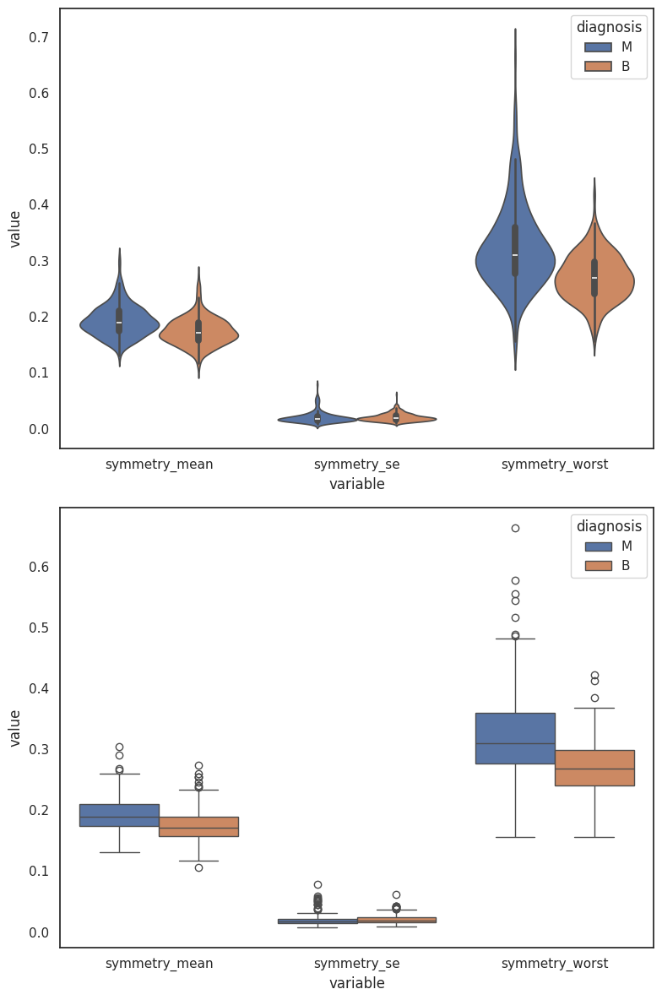

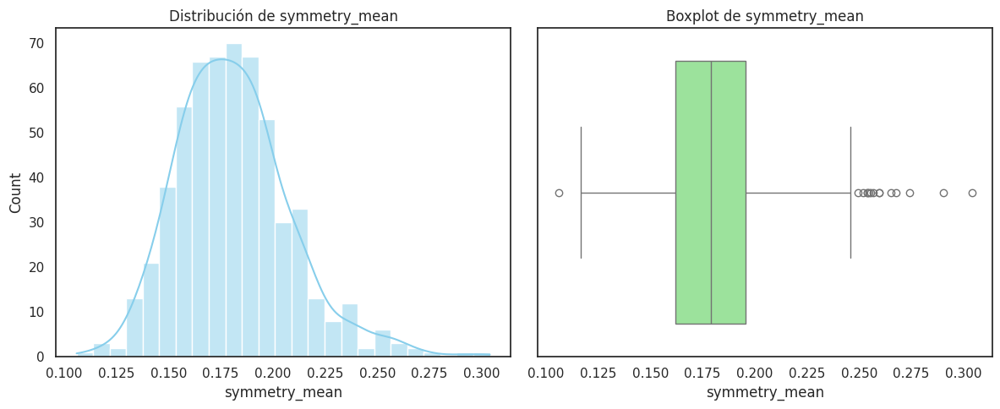

In [14]:
# Conjunto de columnas del set 6
columns_set_6 = ['diagnosis', 'symmetry_mean', 'symmetry_se', 'symmetry_worst']
df_set_6 = pd.DataFrame(df, columns=columns_set_6)

# Crear dos subgráficas: una para violin plot y otra para box plot
fig, axs = plt.subplots(2, figsize=(8, 12))

# Violin plot para distribución por diagnóstico
sns.violinplot(
    x="variable",
    y="value",
    hue="diagnosis",
    data=pd.melt(df_set_6, id_vars='diagnosis'),
    scale="width",
    ax=axs[0]
)

# Box plot para comparación por diagnóstico
sns.boxplot(
    x="variable",
    y="value",
    hue="diagnosis",
    data=pd.melt(df_set_6, id_vars='diagnosis'),
    ax=axs[1]
)

plt.tight_layout()
plt.show()

def get_box_dist_plot(series, title=''):
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    sns.histplot(series, kde=True, ax=axs[0], color='skyblue')
    axs[0].set_title(f'Distribución de {title}')

    sns.boxplot(x=series, ax=axs[1], color='lightgreen')
    axs[1].set_title(f'Boxplot de {title}')

    plt.tight_layout()
    plt.show()


# Llamar la función adicional por separado (si existe en tu código)
get_box_dist_plot(df["symmetry_mean"], title='symmetry_mean')

Projecting the 30-dimensional data to 2D


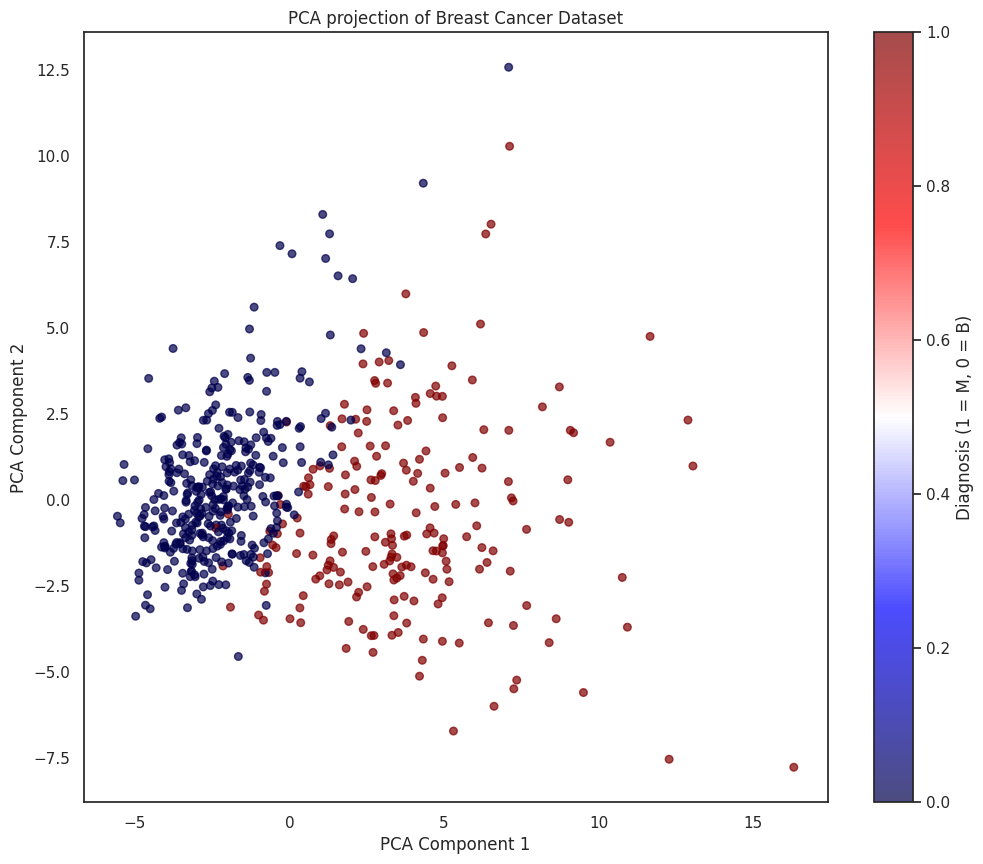

In [15]:
X = df.drop(['diagnosis', 'id'], axis=1)
y = df['diagnosis']

X_scaled = StandardScaler().fit_transform(X)

pca = PCA(n_components=2)
X_pca_scaled = pca.fit_transform(X_scaled)

print('Projecting the 30-dimensional data to 2D')
plt.figure(figsize=(12, 10))
color_labels = y.map({'M': 1, 'B': 0})

plt.scatter(
    X_pca_scaled[:, 0], X_pca_scaled[:, 1],
    c=color_labels,
    alpha=0.7,
    s=30,
    cmap='seismic'
)
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('PCA projection of Breast Cancer Dataset')
plt.colorbar(label='Diagnosis (1 = M, 0 = B)')
plt.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 569 samples in 0.000s...
[t-SNE] Computed neighbors for 569 samples in 0.041s...
[t-SNE] Computed conditional probabilities for sample 569 / 569
[t-SNE] Mean sigma: 1.414330
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.945404
[t-SNE] KL divergence after 500 iterations: 0.931901


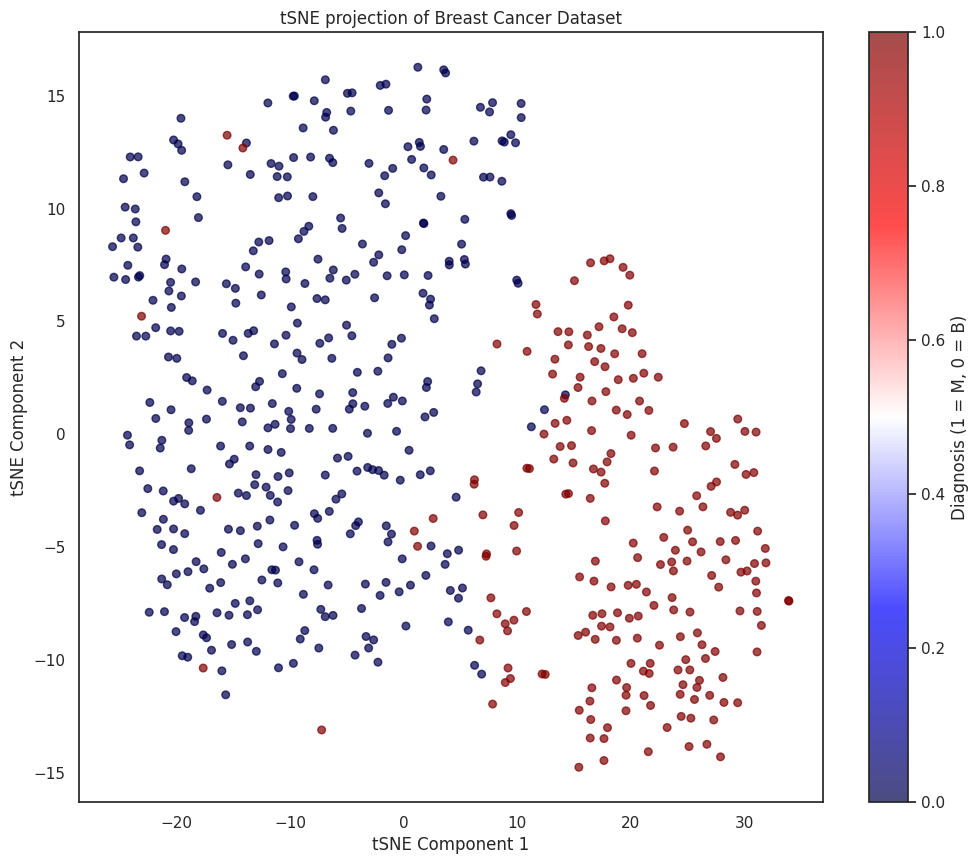

In [16]:
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

X = df.drop(['diagnosis', 'id'], axis=1)
y = df['diagnosis']

X_scaled = StandardScaler().fit_transform(X)

tSNE = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=500)
tSNE_results = tSNE.fit_transform(X_scaled)

color_labels = y.map({'M': 1, 'B': 0})

plt.figure(figsize=(12, 10))
plt.scatter(
    tSNE_results[:, 0],
    tSNE_results[:, 1],
    c=color_labels,
    alpha=0.7,
    s=30,
    cmap='seismic'
)
plt.xlabel('tSNE Component 1')
plt.ylabel('tSNE Component 2')
plt.title('tSNE projection of Breast Cancer Dataset')
plt.colorbar(label='Diagnosis (1 = M, 0 = B)')
plt.show()

In [17]:
X = df.drop(['diagnosis', 'id'], axis=1)
y = df['diagnosis'].map({'M': 1, 'B': 0})

In [18]:
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [22]:
print("Modelo Base")
base_model = DecisionTreeClassifier(random_state=42)
base_model.fit(X_train, y_train)

Modelo Base


DecisionTreeClassifier(random_state=42)

In [27]:
y_pred_test = base_model.predict(X_test)
print(f"\nAccuracy (test): {accuracy_score(y_test, y_pred_test):.4f}")
print("\nClassification Report (Test):")
print(classification_report(y_test, y_pred_test, target_names=['Benigno (B)', 'Maligno (M)']))


Accuracy (test): 0.9474

Classification Report (Test):
              precision    recall  f1-score   support

 Benigno (B)       0.96      0.96      0.96        71
 Maligno (M)       0.93      0.93      0.93        43

    accuracy                           0.95       114
   macro avg       0.94      0.94      0.94       114
weighted avg       0.95      0.95      0.95       114



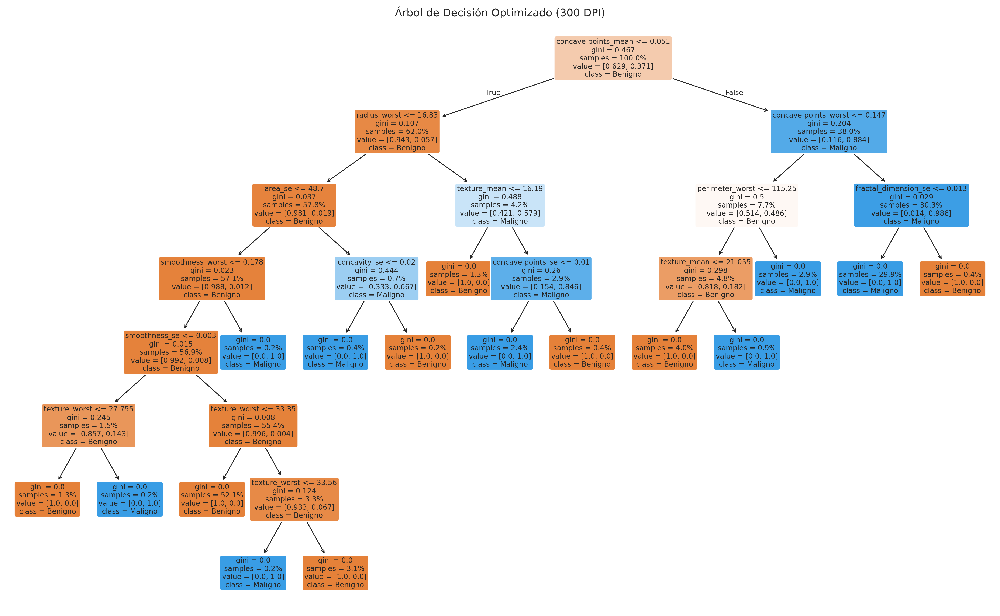

In [28]:
plt.figure(figsize=(20, 12), dpi=300)
plot_tree(
    base_model,
    feature_names=X.columns,
    class_names=['Benigno', 'Maligno'],
    filled=True,
    rounded=True,
    proportion=True,
    fontsize=8
)
plt.title("Árbol de Decisión Optimizado (300 DPI)", fontsize=12)
plt.savefig('arbol_decision.png', dpi=300, bbox_inches='tight')  # Guardar imagen en 300 DPI
plt.show()

EXPERIMENTAL

In [29]:
print("\n=== OPTIMIZACIÓN ===")
param_grid = {
    'max_depth': [3, 5, 7, None],
    'min_samples_split': [2, 5, 10],
    'criterion': ['gini', 'entropy']
}

grid_search = GridSearchCV(
    DecisionTreeClassifier(random_state=42),
    param_grid,
    cv=5,
    scoring='accuracy'
)
grid_search.fit(X_train, y_train)


=== OPTIMIZACIÓN ===


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [3, 5, 7, None],
                         'min_samples_split': [2, 5, 10]},
             scoring='accuracy')

In [30]:
best_model = grid_search.best_estimator_
print(f"\nMejores parámetros: {grid_search.best_params_}")


Mejores parámetros: {'criterion': 'entropy', 'max_depth': 3, 'min_samples_split': 2}


In [31]:
y_pred_best = best_model.predict(X_test)
print(f"\nAccuracy (optimizado): {accuracy_score(y_test, y_pred_best):.4f}")
print("\nClassification Report (optimizado):")
print(classification_report(y_test, y_pred_best, target_names=['Benigno', 'Maligno']))


Accuracy (optimizado): 0.9649

Classification Report (optimizado):
              precision    recall  f1-score   support

     Benigno       0.95      1.00      0.97        71
     Maligno       1.00      0.91      0.95        43

    accuracy                           0.96       114
   macro avg       0.97      0.95      0.96       114
weighted avg       0.97      0.96      0.96       114

